<a href="https://colab.research.google.com/github/mangsshinde/auto_img_capt/blob/master/Results_50_epochs_Image_Caption_Keras.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Libraries

In [ ]:
# !pip install tensorflow==2.8

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 668.3 MB 18 kB/s 
     |████████████████████████████████| 462 kB 23.3 MB/s 
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.8.2+zzzcolab20220719082949
    Uninstalling tensorflow-2.8.2+zzzcolab20220719082949:
      Successfully uninstalled tensorflow-2.8.2+zzzcolab20220719082949


In [ ]:
# !apt install --allow-change-held-packages libcudnn8=8.1.0.77-1+cuda11.2

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following packages will be REMOVED:
  libcudnn8-dev
The following held packages will be changed:
  libcudnn8
The following packages will be upgraded:
  libcudnn8
1 upgraded, 0 newly installed, 1 to remove and 17 not upgraded.
Need to get 430 MB of archives.
After this operation, 3,139 MB disk space will be freed.
Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  libcudnn8 8.1.0.77-1+cuda11.2 [430 MB]
Fetched 430 MB in 14s (31.4 MB/s)
(Reading database ... 155680 files and directories currently installed.)
Removing libcudnn8-dev (8.0.5.39-1+cuda11.1) ...
(Reading database ... 155658 files and directories currently installed.)
Preparing to unpack .../libcudnn8_8.1.0.77-1+cuda11.2_amd64.deb ...
Unpacking libcudnn8 (8.1.0.77-1+

In [ ]:
# !pip install tensorflow-gpu==2.2.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 516.2 MB 4.5 kB/s 
     |████████████████████████████████| 26.1 MB 1.4 MB/s 
     |████████████████████████████████| 454 kB 62.4 MB/s 
     |████████████████████████████████| 2.9 MB 52.3 MB/s 
     |████████████████████████████████| 3.0 MB 48.3 MB/s 
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.8.0
    Uninstalling tensorflow-estimator-2.8.0:
      Successfully uninstalled tensorflow-estimator-2.8.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.8.0
    Uninstalling tensorboard-2.8.0:
      Successfully uninstalled tensorboard-2.8.0
  Attempting uninstall: scipy
    Found existing installation: scipy 1.7.3
    Uninstalling scipy-1.7.3:
      Successfully uninstalled scipy-1.7.3
  Attempting uninstall: h5py
    Found existing installation: h5py 3.1.0
    Unins

In [ ]:
# !pip uninstall keras

Found existing installation: keras 2.8.0
Uninstalling keras-2.8.0:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/keras-2.8.0.dist-info/*
    /usr/local/lib/python3.7/dist-packages/keras/*
Proceed (y/n)? y
  Successfully uninstalled keras-2.8.0


In [ ]:
# !pip install tensorflow --upgrade --force-reinstall

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 511.7 MB 6.2 kB/s 
     |████████████████████████████████| 14.1 MB 52.7 MB/s 
     |████████████████████████████████| 1.2 MB 54.5 MB/s 
     |████████████████████████████████| 438 kB 65.3 MB/s 
     |████████████████████████████████| 4.5 MB 60.4 MB/s 
     |████████████████████████████████| 1.1 MB 61.1 MB/s 
     |████████████████████████████████| 1.6 MB 51.1 MB/s 
     |████████████████████████████████| 4.1 MB 62.1 MB/s 
     |████████████████████████████████| 42 kB 1.7 MB/s 
     |████████████████████████████████| 15.7 MB 55.7 MB/s 
     |████████████████████████████████| 65 kB 5.2 MB/s 
     |████████████████████████████████| 5.8 MB 49.9 MB/s 
     |████████████████████████████████| 40 kB 7.2 MB/s 
     |████████████████████████████████| 2.4 MB 65.8 MB/s 
     |████████████████████████████████| 75 kB 4.5 MB/s 
     |██████████████████████████████

In [ ]:
import warnings
warnings.filterwarnings(action='ignore')
import numpy as np
from numpy import array
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import string
import os
from PIL import Image
import glob
from pickle import dump, load
from time import time
from tensorflow.keras.preprocessing import sequence
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Embedding, TimeDistributed, Dense, RepeatVector,\
                         Activation, Flatten, Reshape, concatenate, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam, RMSprop
from tensorflow.keras.layers import Bidirectional
from tensorflow.keras.layers import add
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model
from tensorflow.keras import Input, layers
from tensorflow.keras import optimizers
from tensorflow.keras.applications.inception_v3 import preprocess_input
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import ModelCheckpoint

from os import listdir
from collections import Counter


# Loading dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/Flickr8k_Dataset.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._342872408_04a2832a1b.jpg  
  inflating: Flicker8k_Dataset/3429142249_d09a32e291.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429142249_d09a32e291.jpg  
  inflating: Flicker8k_Dataset/3429194423_98e911a101.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429194423_98e911a101.jpg  
  inflating: Flicker8k_Dataset/3429351222_17ae744daf.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429351222_17ae744daf.jpg  
  inflating: Flicker8k_Dataset/3429351964_531de1bf16.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429351964_531de1bf16.jpg  
  inflating: Flicker8k_Dataset/3429391520_930b153f94.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429391520_930b153f94.jpg  
  inflating: Flicker8k_Dataset/3429465163_fb8ac7ce7f.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429465163_fb8ac7ce7f.jpg  
  inflating: Flicker8k_Dataset/3429581486_4556471d1a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._34295

In [ ]:
!unzip /content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/Flickr8k_text.zip

Archive:  /content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/Flickr8k_text.zip
  inflating: CrowdFlowerAnnotations.txt  
  inflating: ExpertAnnotations.txt   
  inflating: Flickr8k.lemma.token.txt  
  inflating: __MACOSX/._Flickr8k.lemma.token.txt  
  inflating: Flickr8k.token.txt      
  inflating: Flickr_8k.devImages.txt  
  inflating: Flickr_8k.testImages.txt  
  inflating: Flickr_8k.trainImages.txt  
  inflating: readme.txt              


# Load Captions

In [ ]:
def load_doc(filename):
    with open(filename) as file:
        text = file.readlines()
        return text

filename = "/content/Flickr8k.token.txt"
text = load_doc(filename)
for line in text[:10]:
    print(line,end='')

# every image has 5 captions

1000268201_693b08cb0e.jpg#0	A child in a pink dress is climbing up a set of stairs in an entry way .
1000268201_693b08cb0e.jpg#1	A girl going into a wooden building .
1000268201_693b08cb0e.jpg#2	A little girl climbing into a wooden playhouse .
1000268201_693b08cb0e.jpg#3	A little girl climbing the stairs to her playhouse .
1000268201_693b08cb0e.jpg#4	A little girl in a pink dress going into a wooden cabin .
1001773457_577c3a7d70.jpg#0	A black dog and a spotted dog are fighting
1001773457_577c3a7d70.jpg#1	A black dog and a tri-colored dog playing with each other on the road .
1001773457_577c3a7d70.jpg#2	A black dog and a white dog with brown spots are staring at each other in the street .
1001773457_577c3a7d70.jpg#3	Two dogs of different breeds looking at each other on the road .
1001773457_577c3a7d70.jpg#4	Two dogs on pavement moving toward each other .


# Mapping image with captions

In [ ]:
def image_to_captions(text):
    hash_map = {}
    for line in text:
        token = line.split()
        image_id = token[0].split('.')[0] # separating with '.' to extract image id (removing .jpg)
        image_caption = ' '.join(token[1: ])
        
        if(image_id not in hash_map):
            hash_map[image_id] = [image_caption]
        else:
            hash_map[image_id].append(image_caption)
        
    return hash_map
        

map_img_to_captions = image_to_captions(text)
print(*map_img_to_captions['1000268201_693b08cb0e'],sep='\n')

A child in a pink dress is climbing up a set of stairs in an entry way .
A girl going into a wooden building .
A little girl climbing into a wooden playhouse .
A little girl climbing the stairs to her playhouse .
A little girl in a pink dress going into a wooden cabin .


# Data Preprocessing

In [ ]:
def preprocess(map_img_to_captions):
    preprocessed_captions = []
    for key in map_img_to_captions.keys():
        for idx in range(len(map_img_to_captions[key])):
            tokens = map_img_to_captions[key][idx].split()
            tokens = [token.lower() for token in tokens if len(token)>1 if token.isalpha()]
            map_img_to_captions[key][idx] = ' '.join(tokens)
            
    return map_img_to_captions


preprocessed_map = preprocess(map_img_to_captions)
preprocessed_map['1000268201_693b08cb0e']

['child in pink dress is climbing up set of stairs in an entry way',
 'girl going into wooden building',
 'little girl climbing into wooden playhouse',
 'little girl climbing the stairs to her playhouse',
 'little girl in pink dress going into wooden cabin']

# Create vocabulary from captions

In [ ]:
def create_vocabulary(preprocessed_map):
    vocabulary = set()
    for img_captions in preprocessed_map.values(): # list of 5 captions for each image
        for caption in img_captions:
            for token in caption.split():
                vocabulary.add(token)    
    return vocabulary


vocabulary = create_vocabulary(preprocessed_map)
print('Vocabulary size',len(vocabulary))

Vocabulary size 8357


# Saving image id and preprocessed captions to new text file

In [ ]:
def save_captions(preprocessed_map,filename):
    data = []
    for image_id,image_captions in preprocessed_map.items():
        for caption in image_captions:
            data.append(image_id + ' ' + caption + '\n')
            
    with open(filename,'w') as file:
        for line in data:
            file.write(line)

save_captions(preprocessed_map,'preprocessed_captions.txt')

# Load images (image name) of Train & Test Data

In [ ]:
def img_id_train(filename):
    with open(filename) as file:
        data = file.readlines()
        train_img_name = []
        for img_id in data:
            train_img_name.append(img_id.split('.')[0])
    return train_img_name    

train_img_name = img_id_train('/content/Flickr_8k.trainImages.txt')
# test_img_name  = img_id_train('/content/Flickr_8k.testImages.txt')
print(*train_img_name[:5],sep='\n')
print('\nNumber of images in train data',len(train_img_name))
# print('\nNumber of images in train data',len(test_img_name))

2513260012_03d33305cf
2903617548_d3e38d7f88
3338291921_fe7ae0c8f8
488416045_1c6d903fe0
2644326817_8f45080b87

Number of images in train data 6000


In [ ]:
train_img_name[0]

'2513260012_03d33305cf'

# Load pre-processed captions for Train data (add 'startseq' & 'endseq')

In [ ]:
def load_captions_train(filename):
    doc = load_doc(filename) 
    train_captions = {}    
    
    for line in doc:
        tokens = line.split()
        image_id, image_caption = tokens[0], tokens[1:]

        if(image_id in train_img_name):
            if(image_id not in train_captions):
                train_captions[image_id] = []
            
            modified_caption = 'startseq ' + ' '.join(image_caption) + ' endseq'
            train_captions[image_id].append(modified_caption)
    
    return train_captions


train_captions = load_captions_train('preprocessed_captions.txt')
print(*train_captions['1000268201_693b08cb0e'],sep='\n')

startseq child in pink dress is climbing up set of stairs in an entry way endseq
startseq girl going into wooden building endseq
startseq little girl climbing into wooden playhouse endseq
startseq little girl climbing the stairs to her playhouse endseq
startseq little girl in pink dress going into wooden cabin endseq


In [ ]:
def preprocess_image(img_path):
    img = image.load_img(img_path,target_size=(299,299)) 
    # type(img): PIL.Image.Image
#     plt.figure(figsize=(12,6))
#     plt.subplot(121)
#     plt.imshow(img)
#     plt.title('Original Image(Resized)')

    img = image.img_to_array(img) # Converts PIL Image instance to numpy array (299,299,3)
    img = np.expand_dims(img, axis=0) #Add one more dimension: (1, 299, 299, 3) # Inception-V3 requires 4 dimensions
    img = preprocess_input(img) # preprocess image as per Inception-V3 model
#     plt.subplot(122)
#     plt.imshow(img[0])
#     plt.title('Preprocessed image for Inception-V3')    
    
    return img  # shape: (1, 299, 299, 3)

In [ ]:
# img = preprocess_image('/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg')
# Image.open('/content/Flicker8k_Dataset/preprocessed_image.PNG')

In [ ]:
# Load Inception-V3 model
model = InceptionV3(weights='imagenet')

# Create new model, by removing last layer (output layer) from Inception-V3
model_new = Model(inputs=model.input, outputs=model.layers[-2].output) # outputs=(second last layer output)

# model.layers            list of layers
# model.input             <tf.Tensor 'input_1:0' shape=(?, ?, ?, 3) dtype=float32>
# model.layers[-1].output <tf.Tensor 'predictions/Softmax:0' shape=(?, 1000) dtype=float32> 1000 target classes
# model.layers[-2].output <tf.Tensor 'avg_pool/Mean:0' shape=(?, 2048) dtype=float32>

96124928/96112376 [==============================] - 3s 0us/step


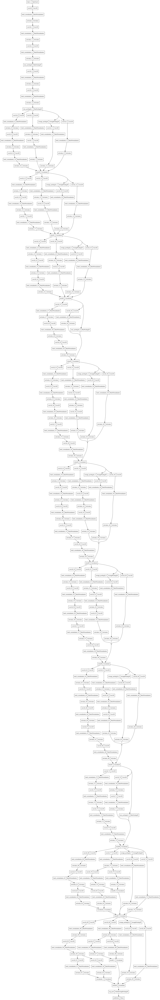

In [ ]:
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model.png')

In [ ]:
model_new.predict(img).shape

NameError: ignored

# All images names

In [ ]:
test_path = '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images'

In [ ]:
for root, dirs, files in os.walk(test_path):
  for file in files:
    print(root+'/'+file)

/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000092795.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000366164.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1001773457.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1003420127.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1005216151.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1009434119.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1012212859.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/101362133.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1015712668.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/10350842.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/data3747007211.jpg
/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/data6744211811.jpg
/content/drive/MyDrive/HTCGlobal/Au

In [ ]:
print('/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000092795.jpg')

/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000092795.jpg


In [ ]:
test_img_name = [root+'/'+file for file in files for root, dirs, files in os.walk(test_path)]

In [ ]:
test_img_name

['/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000092795.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000366164.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1001773457.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1003420127.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1005216151.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1009434119.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1012212859.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/101362133.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1015712668.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/10350842.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/data3747007211.jpg',
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/data6744

In [ ]:
def images_name(path):
    img_name = set([path+image for image in listdir(path)])
    return img_name

path = '/content/Flicker8k_Dataset'
all_images_name = images_name(path)
train_img_name = [path+'/'+img+'.jpg' for img in train_img_name]
# test_img_name = [path+'/'+img+'.jpg' for img in test_img_name]

In [ ]:
train_img_name

['/content/Flicker8k_Dataset/2513260012_03d33305cf.jpg',
 '/content/Flicker8k_Dataset/2903617548_d3e38d7f88.jpg',
 '/content/Flicker8k_Dataset/3338291921_fe7ae0c8f8.jpg',
 '/content/Flicker8k_Dataset/488416045_1c6d903fe0.jpg',
 '/content/Flicker8k_Dataset/2644326817_8f45080b87.jpg',
 '/content/Flicker8k_Dataset/218342358_1755a9cce1.jpg',
 '/content/Flicker8k_Dataset/2501968935_02f2cd8079.jpg',
 '/content/Flicker8k_Dataset/2699342860_5288e203ea.jpg',
 '/content/Flicker8k_Dataset/2638369467_8fc251595b.jpg',
 '/content/Flicker8k_Dataset/2926786902_815a99a154.jpg',
 '/content/Flicker8k_Dataset/2851304910_b5721199bc.jpg',
 '/content/Flicker8k_Dataset/3423802527_94bd2b23b0.jpg',
 '/content/Flicker8k_Dataset/3356369156_074750c6cc.jpg',
 '/content/Flicker8k_Dataset/2294598473_40637b5c04.jpg',
 '/content/Flicker8k_Dataset/1191338263_a4fa073154.jpg',
 '/content/Flicker8k_Dataset/2380765956_6313d8cae3.jpg',
 '/content/Flicker8k_Dataset/3197891333_b1b0fd1702.jpg',
 '/content/Flicker8k_Dataset/3119

# Encode images into feature vectors

In [ ]:
# Function to encode given image into a vector of size (2048, )
def encode_image(image):
    image = preprocess_image(image) # preprocess image
    feature_vector = model_new.predict(image) # Get encoding vector for image
    feature_vector = feature_vector.reshape(feature_vector.shape[1], ) # reshape from (1, 2048) to (2048, )
    return feature_vector


# To encode all train images
# start_train = time()
# encoding_train = {}
# for idx,img in enumerate(train_img_name):
#     if( (idx+1)%500 == 0):
#         print('Train images encoded ',idx+1)
#     encoding_train[img] = encode_image(img)
# print("** Time taken for encoding train images {} seconds **".format(time()-start_train))


# To encode all test images
start_test = time()
encoding_test = {}
for idx,img in enumerate(test_img_name):
    if( (idx+1)%200 == 0):
        print('Test images encoded ',idx+1)
    encoding_test[img] = encode_image(img)
print("** Time taken for encoding test images {} seconds **".format(time()-start_test))

** Time taken for encoding test images 22.622759580612183 seconds **


In [ ]:
# To encode all train images
start_train = time()
encoding_train = {}
for idx,img in enumerate(train_img_name):
    if( (idx+1)%500 == 0):
        print('Train images encoded ',idx+1)
    encoding_train[img] = encode_image(img)
print("** Time taken for encoding train images {} seconds **".format(time()-start_train))

Train images encoded  500
Train images encoded  1000
Train images encoded  1500
Train images encoded  2000
Train images encoded  2500
Train images encoded  3000
Train images encoded  3500
Train images encoded  4000
Train images encoded  4500
Train images encoded  5000
Train images encoded  5500
Train images encoded  6000
** Time taken for encoding train images 430.42974734306335 seconds **


In [ ]:
encoding_test

{'/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000092795.jpg': array([0.18249506, 0.16290572, 0.522696  , ..., 0.6769266 , 0.3285824 ,
        0.08636539], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000366164.jpg': array([0.21459852, 0.32007885, 0.29767153, ..., 0.6216427 , 0.24760336,
        1.110657  ], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1001773457.jpg': array([0.7366836 , 0.59113276, 0.18194166, ..., 0.16030243, 0.34144747,
        0.908317  ], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1003420127.jpg': array([0.15169238, 0.19428912, 0.15381527, ..., 0.        , 0.29475582,
        0.3823561 ], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1005216151.jpg': array([0.40005082, 0.934853  , 0.9329619 , ..., 0.71903396, 0.8525865 ,
        0.21202299], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/

# Save the learned features 

In [ ]:
# # # Save the bottleneck train features to disk
with open("encoded_train_images.pkl", "wb") as encoded_pickle:
    dump(encoding_train, encoded_pickle)
    
# # # Save the bottleneck test features to disk
with open("encoded_test_images.pkl", "wb") as encoded_pickle:
    dump(encoding_test, encoded_pickle)

# All train captions (6000 x 5 = 30,000)

In [ ]:
train_features = load(open("encoded_train_images.pkl", "rb"))

# Create a list of all the training captions
all_train_captions = []
for captions in train_captions.values():
    for caption in captions:
        all_train_captions.append(caption)
    
print(len(all_train_captions))
print(*all_train_captions[:10],sep='\n')

30000
startseq child in pink dress is climbing up set of stairs in an entry way endseq
startseq girl going into wooden building endseq
startseq little girl climbing into wooden playhouse endseq
startseq little girl climbing the stairs to her playhouse endseq
startseq little girl in pink dress going into wooden cabin endseq
startseq black dog and spotted dog are fighting endseq
startseq black dog and dog playing with each other on the road endseq
startseq black dog and white dog with brown spots are staring at each other in the street endseq
startseq two dogs of different breeds looking at each other on the road endseq
startseq two dogs on pavement moving toward each other endseq


# Consider only those words which occur atleast 10 times in corpus

In [ ]:
corpus = []
for caption in all_train_captions:
    for token in caption.split():
        corpus.append(token)
        
hash_map = Counter(corpus)
vocab = []
for token,count in hash_map.items():
    if(count>=10):
        vocab.append(token)
        
print('Number of original tokens',len(hash_map))
print('Number of tokens after threshold',len(vocab))

Number of original tokens 7265
Number of tokens after threshold 1643


# Mapping: Index to words & Word to index

In [ ]:
word_to_index = {}
index_to_word = {}
    
for idx,token in enumerate(vocab):
    word_to_index[token] = idx+1
    index_to_word[idx+1] = token

vocab_size = len(index_to_word) + 1 # one for appended 0's

print(len(index_to_word))


1643


# Calculate max-length caption

In [ ]:
def max_len_caption(all_train_captions):   
    max_len = 0
    for caption in all_train_captions:
        max_len = max(max_len,len(caption.split()))
    print('Maximum length of caption= ',max_len)
    return max_len

max_length_caption = max_len_caption(all_train_captions)

Maximum length of caption=  33


# Data Preparation using Generator Function

In [ ]:
# data generator, intended to be used in a call to model.fit_generator()
def data_generator(descriptions, photos, wordtoix, max_length, num_photos_per_batch):
    X1, X2, y = list(), list(), list()
    n=0
    # loop for ever over images
    while 1:
        for key, desc_list in descriptions.items():
            n+=1
            # retrieve the photo feature
            temp='/content/Flicker8k_Dataset'
            
            photo = photos[temp+'/'+key+'.jpg']
            for desc in desc_list:
                # encode the sequence
                seq = [wordtoix[word] for word in desc.split(' ') if word in wordtoix]
                # split one sequence into multiple X, y pairs
                for i in range(1, len(seq)):
                    # split into input and output pair
                    in_seq, out_seq = seq[:i], seq[i]
                    # pad input sequence
                    in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
                    # encode output sequence
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    # store
                    X1.append(photo)
                    X2.append(in_seq)
                    y.append(out_seq)
            # yield the batch data
            if n==num_photos_per_batch:
                yield [[array(X1), array(X2)], array(y)]
                X1, X2, y = list(), list(), list()
                n=0

# Load GloVe vectors

In [ ]:
embeddings_index = {} # empty dictionary
f = open('/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/glove.6B.200d.txt', encoding="utf-8")

for line in f:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    embeddings_index[word] = coefs
f.close()
print('Found %s word vectors.' % len(embeddings_index))

Found 400000 word vectors.


In [ ]:
embedding_dim = 200

# Get 200-dim dense vector for each of the 10000 words in out vocabulary
embedding_matrix = np.zeros((vocab_size, embedding_dim))

for word, i in word_to_index.items():
    #if i < max_words:
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
        # Words not found in the embedding index will be all zeros
        embedding_matrix[i] = embedding_vector
        
embedding_matrix.shape

(1644, 200)

In [ ]:
# inputs1 = Input(shape=(2048,))
# fe1 = Dropout(0.5)(inputs1)
# fe2 = Dense(256, activation='relu')(fe1)
# inputs2 = Input(shape=(max_length_caption,))
# se1 = Embedding(vocab_size, embedding_dim, mask_zero=True)(inputs2)
# se2 = Dropout(0.5)(se1)
# se3 = LSTM(256)(se2)
# decoder1 = add([fe2, se3])
# decoder2 = Dense(256, activation='relu')(decoder1)
# outputs = Dense(vocab_size, activation='softmax')(decoder2)
# model = Model(inputs=[inputs1, inputs2], outputs=outputs)

model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 33)]         0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, 2048)]       0           []                               
                                                                                                  
 embedding (Embedding)          (None, 33, 200)      328800      ['input_3[0][0]']                
                                                                                                  
 dropout (Dropout)              (None, 2048)         0           ['input_2[0][0]']                
                                                                                            

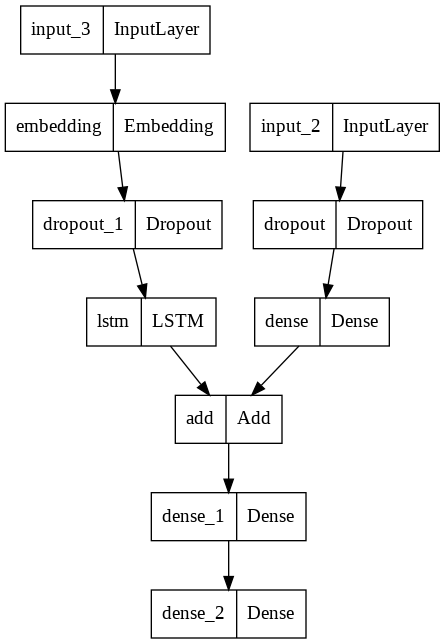

In [ ]:
# from tensorflow.keras.utils import plot_model
# plot_model(model, to_file='model.png')

In [ ]:
# print(model.layers[2])

# model.layers[2].set_weights([embedding_matrix])
# model.layers[2].trainable = False

In [ ]:
# model.compile(loss='categorical_crossentropy', optimizer='adam')

In [ ]:
# epochs = 20
# number_pics_per_bath = 3
# steps = len(train_captions)//number_pics_per_bath

In [ ]:
temp='/content/Flicker8k_Dataset'
temp

'/content/Flicker8k_Dataset'

In [ ]:
# for i in range(epochs):
#     generator = data_generator(train_captions, train_features, word_to_index, max_length_caption, number_pics_per_bath)
#     model.fit_generator(generator, epochs=1, steps_per_epoch=steps, verbose=1)
#     model.save('/content/model_weights/model_' + str(i) + '.h5')
# Image.open('training_1.PNG')

2000/2000 [==============================] - 191s 96ms/step - loss: 2.4428


In [ ]:
# model.save_weights('./model_weights/model_30.h5')
# model.load_weights('./model_weights/model_30.h5')

images = ''
with open("encoded_test_images.pkl", "rb") as encoded_pickle:
    encoding_test = load(encoded_pickle)
    
def greedySearch(photo):
    in_text = 'startseq'
    for i in range(max_length_caption):
        sequence = [word_to_index[w] for w in in_text.split() if w in word_to_index]
        sequence = pad_sequences([sequence], maxlen=max_length_caption)
        yhat = model.predict([photo,sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = index_to_word[yhat]
        in_text += ' ' + word
        if word == 'endseq':
            break
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    return final

In [ ]:
# z=0
# pic = list(encoding_test.keys())[z]
# image = encoding_test[pic].reshape((1,2048))
# x=plt.imread(images+pic)
# plt.imshow(x)
# plt.show()
# print(z,"Caption:",greedySearch(image))
# Image.open('inference.PNG')

In [ ]:
# !zip -r models.zip /content/model_weights

In [ ]:
from tensorflow.keras.models import load_model

In [ ]:
model_test = load_model('/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/model_19.h5')

In [ ]:
def greedySearch2(photo):
    in_text = 'startseq'
    for i in range(max_length_caption):
        sequence = [word_to_index[w] for w in in_text.split() if w in word_to_index]
        sequence = pad_sequences([sequence], maxlen=max_length_caption)
        yhat = model_test.predict([photo,sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = index_to_word[yhat]
        in_text += ' ' + word
        if word == 'endseq':
            break
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    return final

In [ ]:
lst2 = [0,80,180,230,290,323,325,375,404,408,427,436,458,999,997,990,800]
for z in lst2:
  pic = list(encoding_test.keys())[z]
  image = encoding_test[pic].reshape((1,2048))
  x=plt.imread(images+pic)
  plt.imshow(x)
  plt.show()
  print("Caption:",greedySearch2(image))

# Testing with other images

## 5. model

In [ ]:
##model_test
from tensorflow.keras.models import load_model
model_test = load_model('/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/model_49.h5')

## 6. images

In [ ]:
##images
images = ''

In [ ]:
encoding_test

{'/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000092795.jpg': array([0.18249506, 0.16290572, 0.522696  , ..., 0.6769266 , 0.3285824 ,
        0.08636539], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1000366164.jpg': array([0.21459852, 0.32007885, 0.29767153, ..., 0.6216427 , 0.24760336,
        1.110657  ], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1001773457.jpg': array([0.7366836 , 0.59113276, 0.18194166, ..., 0.16030243, 0.34144747,
        0.908317  ], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1003420127.jpg': array([0.15169238, 0.19428912, 0.15381527, ..., 0.        , 0.29475582,
        0.3823561 ], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/Automatic_Image_cap/test_images/1005216151.jpg': array([0.40005082, 0.934853  , 0.9329619 , ..., 0.71903396, 0.8525865 ,
        0.21202299], dtype=float32),
 '/content/drive/MyDrive/HTCGlobal/

In [ ]:
##creating function for making predictions on test data
def greedySearch2(photo):
    in_text = 'startseq'
    for i in range(max_length_caption):
        sequence = [word_to_index[w] for w in in_text.split() if w in word_to_index]
        sequence = pad_sequences([sequence], maxlen=max_length_caption)
        yhat = model_test.predict([photo,sequence], verbose=0)
        yhat = np.argmax(yhat)
        word = index_to_word[yhat]
        in_text += ' ' + word
        if word == 'endseq':
            break
    final = in_text.split()
    final = final[1:-1]
    final = ' '.join(final)
    return final

In [ ]:
for i in range(len(encoding_test)):
  print(i)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111


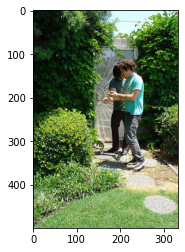

Caption: small boy in straw shirt is walking along path


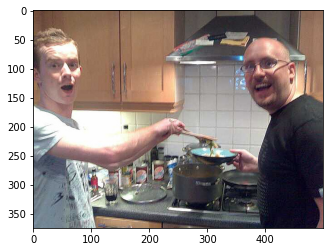

Caption: man in white shirt is sitting on the floor next to table reading


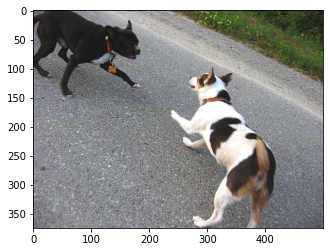

Caption: black dog is running through the grass


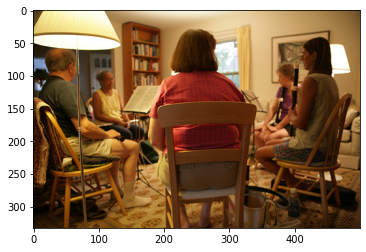

Caption: man in white shirt is sitting on stool


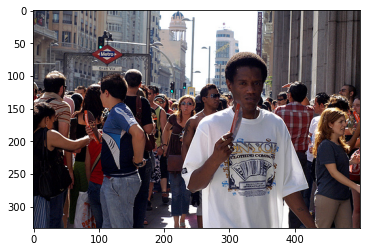

Caption: group of people are standing around monument waving american flags


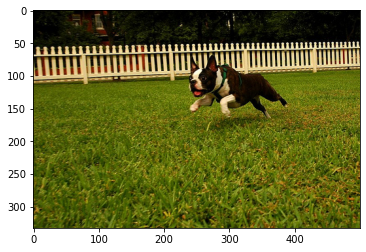

Caption: black and white dog is running through grassy field


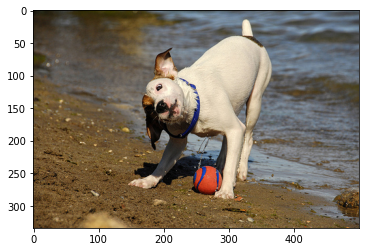

Caption: white dog is running through the grass


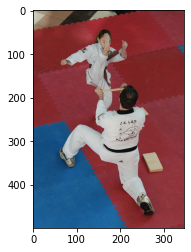

Caption: boy in red shirt is swinging bat at baseball bat


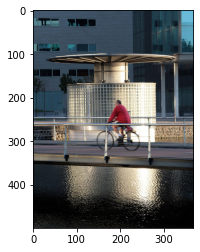

Caption: two girls are playing on the floor


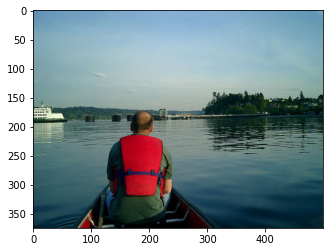

Caption: two people are sitting on the water and in the blue


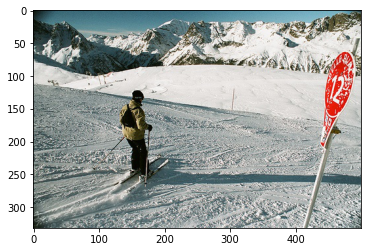

Caption: man skis down snowy mountain


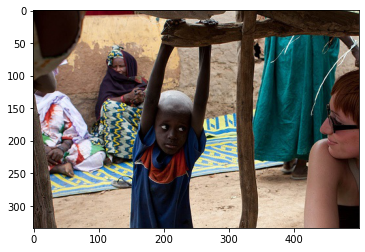

Caption: two children are playing on the grass


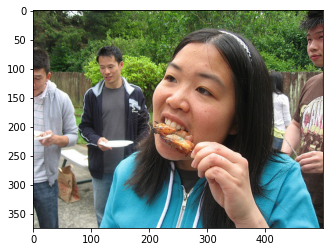

Caption: man in red shirt and jeans is eating piece of fruit


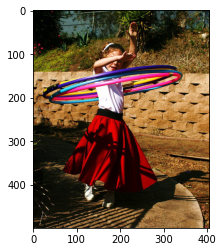

Caption: two girls are playing on the grass


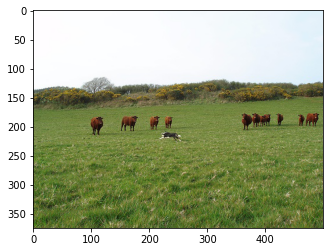

Caption: two dogs are playing with basketball and one is carrying frisbee


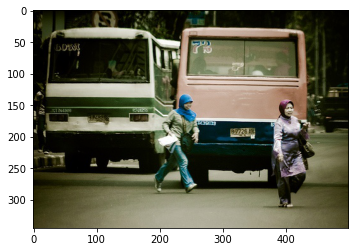

Caption: man in red shirt is standing on sidewalk


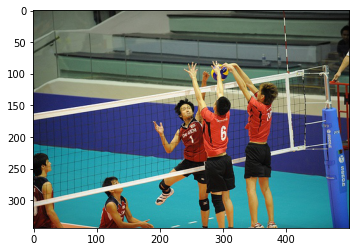

Caption: two men are playing basketball on the grass


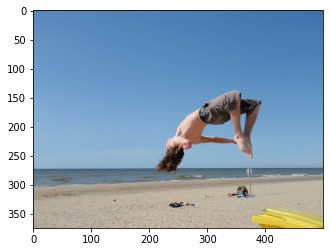

Caption: boy in red swim trunks jumping into the water


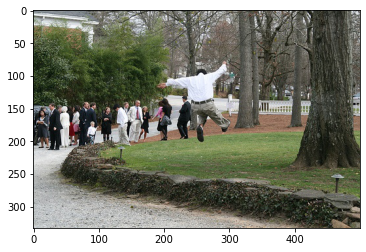

Caption: two people work animals stretches in front of store


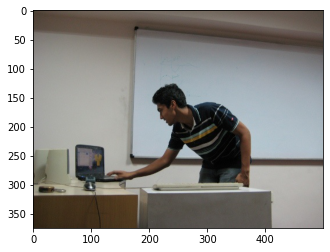

Caption: man in white shirt is standing in front of doorway


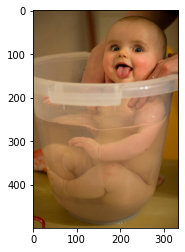

Caption: baby in life jacket is sitting on the ground next to someone


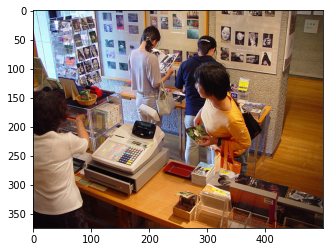

Caption: man in apron is sitting on the middle of an machine


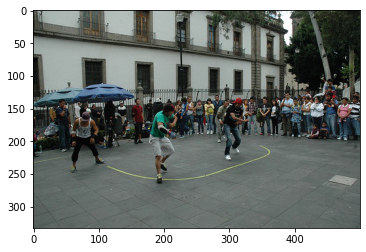

Caption: two men in camouflage pants are standing on stage


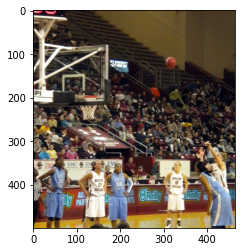

Caption: two men in karate uniforms are fighting on the street


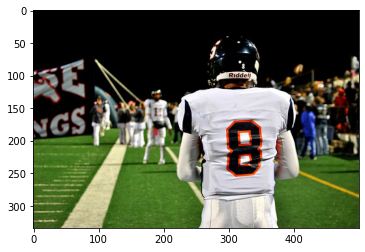

Caption: man in red shirt and hat is holding football


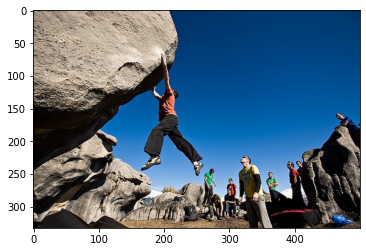

Caption: man is climbing cliff face


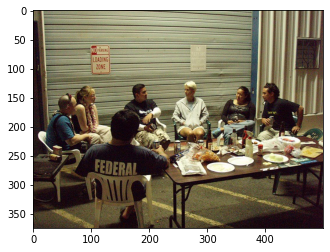

Caption: man in white shirt is sitting on the stage at night


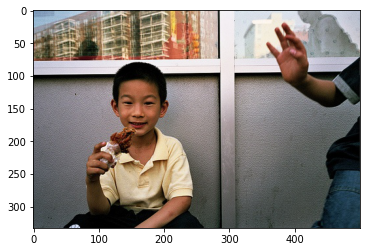

Caption: man in white shirt and jeans is sitting on the grass by wall


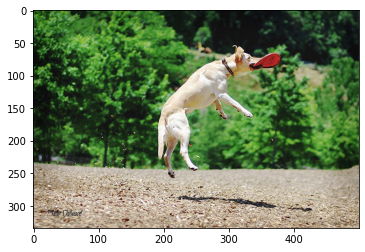

Caption: dog runs through the grass


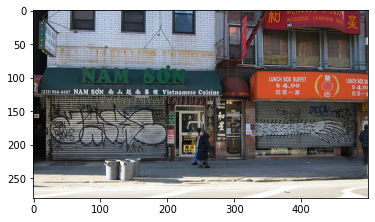

Caption: man in white shirt is standing outside of building


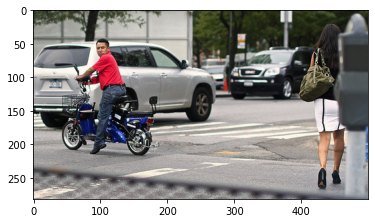

Caption: man in red shirt and hat is riding bicycle down street


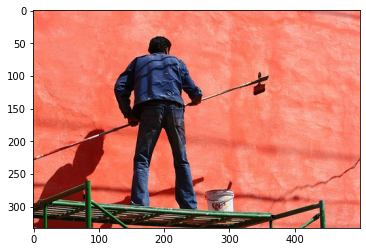

Caption: man in red jacket is sitting on bench near the water


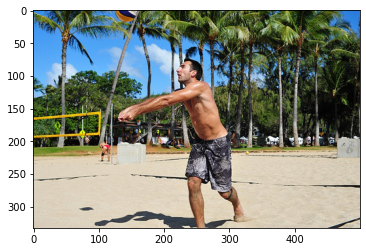

Caption: boy in red shorts jumps into the air as he falls into the air


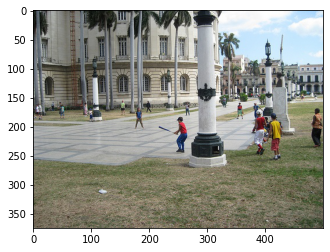

Caption: man in white shirt is standing on the street


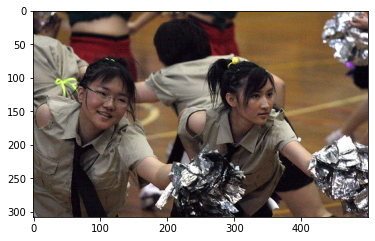

Caption: man in white shirt and cap is standing in crowd of people


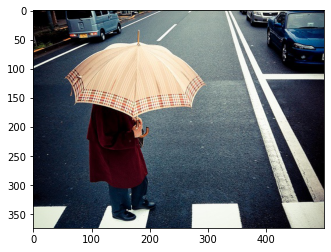

Caption: man in red shirt and hat is standing in front of plant shop


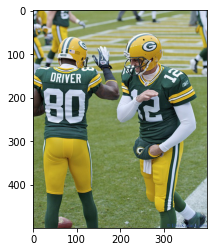

Caption: two men in red and white uniforms are playing rugby


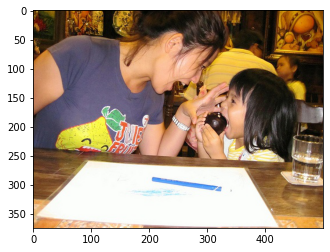

Caption: man in white shirt and hat is holding up up up up to palm


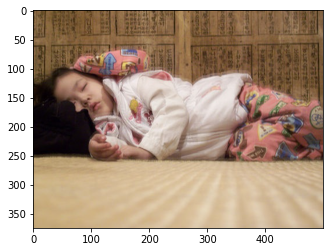

Caption: baby in red shirt is sleeping on bed


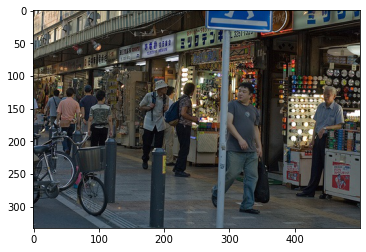

Caption: man in black jacket is standing outside of shop


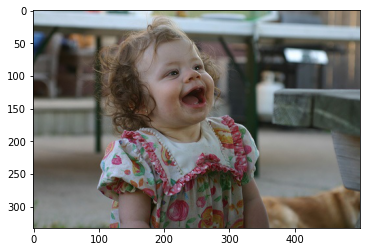

Caption: small boy in blue shirt is running through grassy area


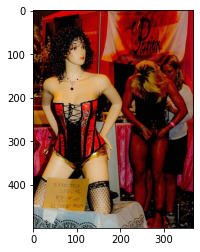

Caption: group of children are dressed in costume and are smiling and waving


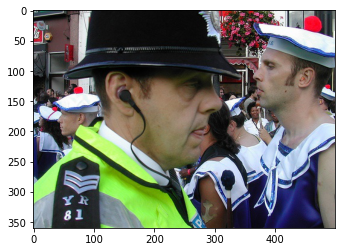

Caption: police officer stands by group of people


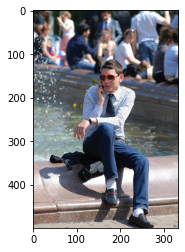

Caption: man in dark clothes is sitting on cement wall


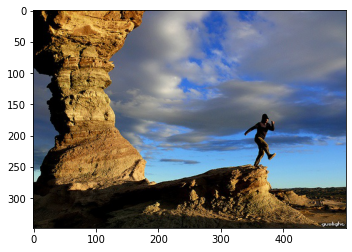

Caption: man is climbing up rock face


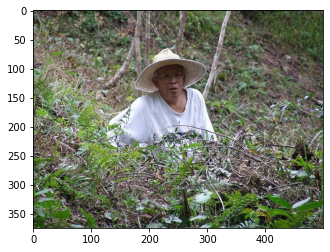

Caption: little boy in red shirt is smiling whilst standing on the grass


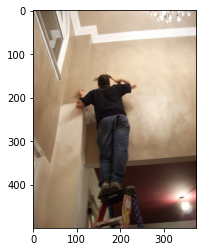

Caption: man in white shirt and jeans is sleeping on concrete courtyard


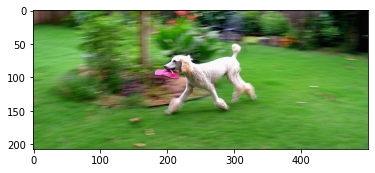

Caption: dog runs through the grass


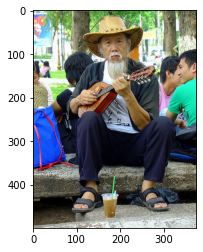

Caption: man wearing black jacket and black pants sitting on bench reading book


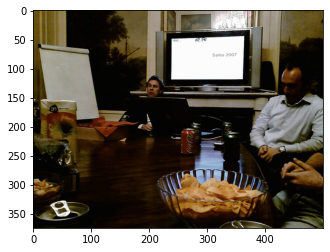

Caption: man in white shirt is sitting on stool


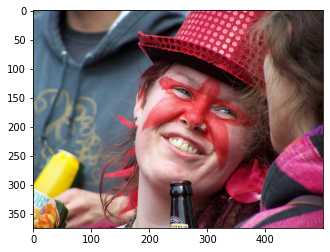

Caption: boy with dirty face paint face


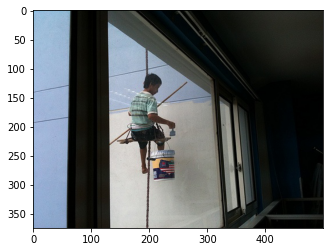

Caption: man in white shirt and jeans is standing outside of building


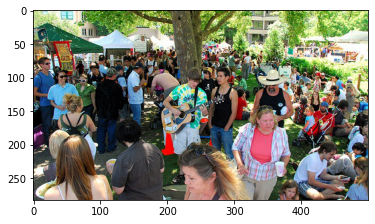

Caption: group of people gather to are gathered outside building


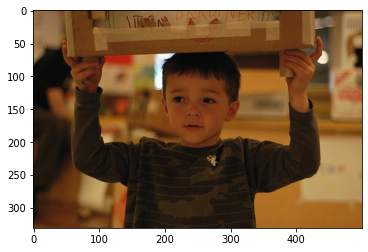

Caption: boy in red shirt is sitting on the floor


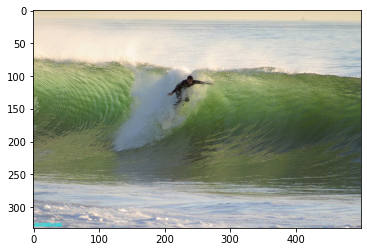

Caption: man is standing by water


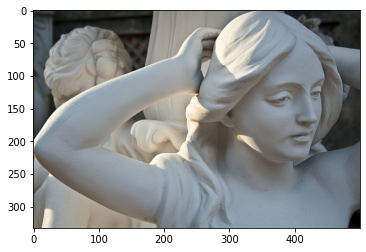

Caption: young boy wearing red shirt is laying on bed


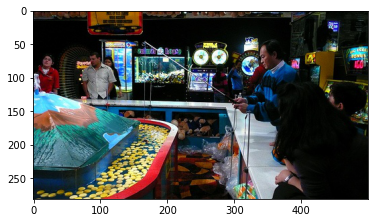

Caption: figure shop in front of restaurant


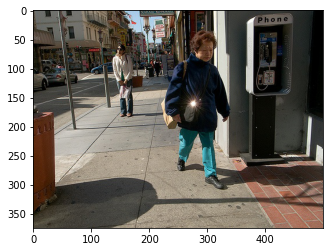

Caption: man in red shirt is standing on sidewalk near some bicycles


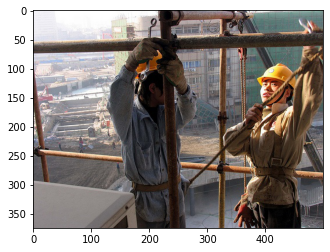

Caption: man in red shirt and hat is sitting against brick wall


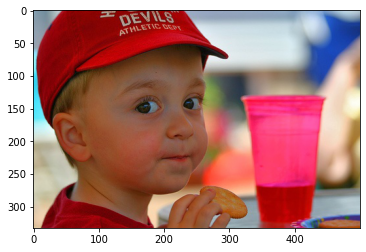

Caption: small boy in blue shirt is licking the water from his reflection


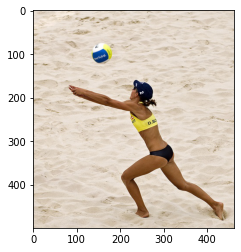

Caption: two boys are playing in the water


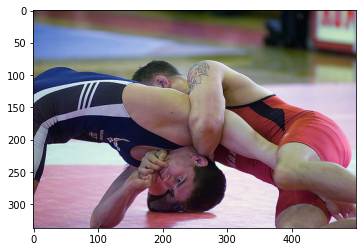

Caption: two boys in swim trunks are playing in the wet


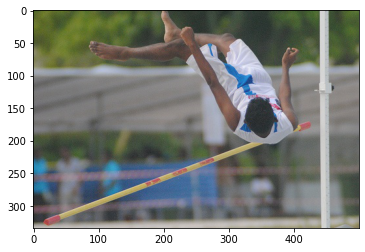

Caption: the german shepherd is jumping over fallen tree


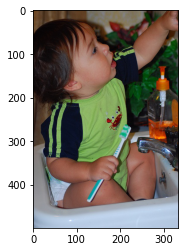

Caption: baby in blue shirt eating cake


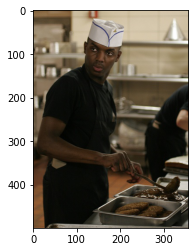

Caption: man in white shirt and overalls is writing


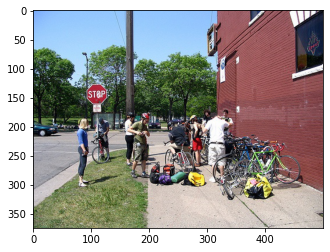

Caption: man in red and red is riding bicycle on street


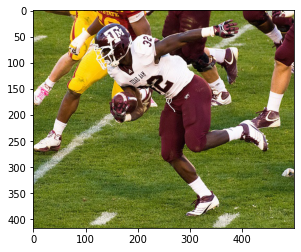

Caption: two men play football


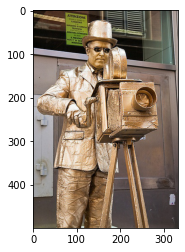

Caption: man in black jacket is writing


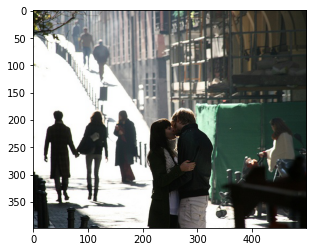

Caption: man in white shirt and hat is waiting on the sidewalk near building


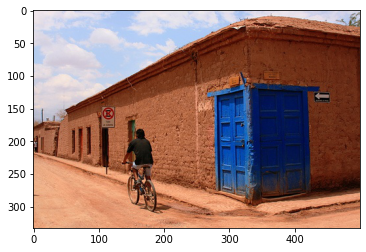

Caption: man in red jacket is standing on sidewalk near the ocean


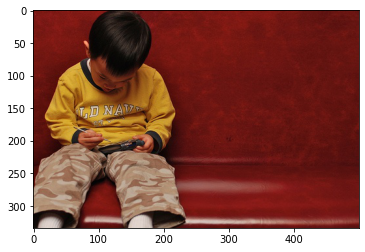

Caption: boy in red shirt is sleeping on bed


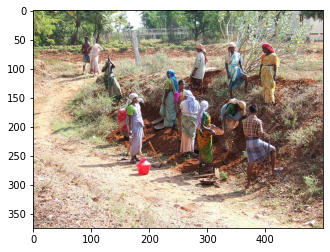

Caption: group of people are sitting on rocks near waterfall


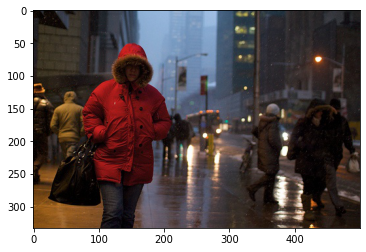

Caption: man in black jacket and hat is waiting to cross the street


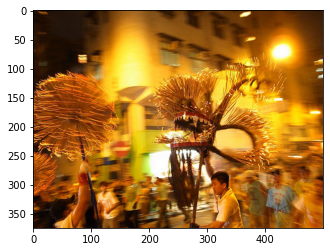

Caption: man in white shirt is standing in front of music onstage


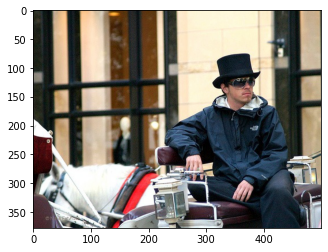

Caption: man in wheelchair hat sits on the sidewalk reading book


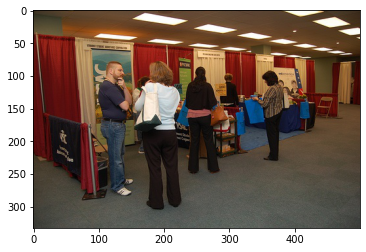

Caption: man in white shirt and tie is standing in front of students


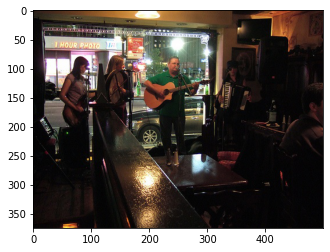

Caption: man in white shirt is standing in front of restaurant


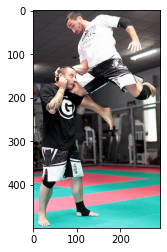

Caption: two men in red shorts are playing basketball


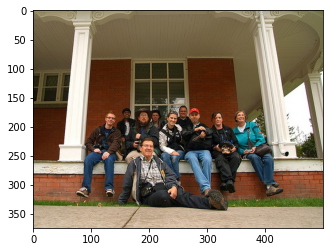

Caption: man in white shirt and jeans is waiting on the sidewalk near some bicycles


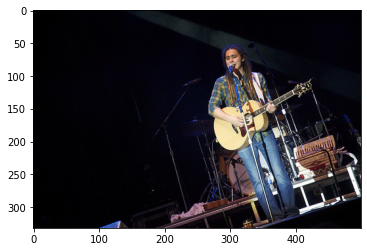

Caption: man playing guitar as well in the foreground


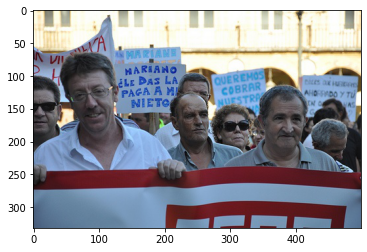

Caption: man in white cap and hat is writing


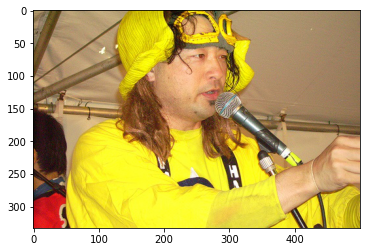

Caption: man playing the drums


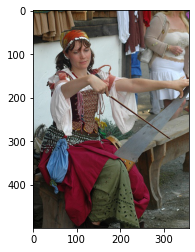

Caption: man and woman are kissing


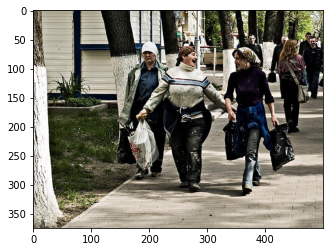

Caption: man in red scarf stands on sidewalk


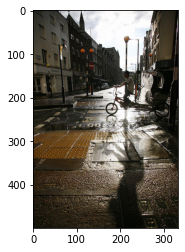

Caption: man in white shirt and hat is standing on sidewalk between houses


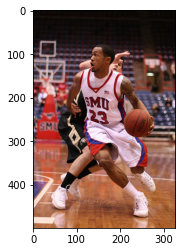

Caption: basketball player dribbles the ball


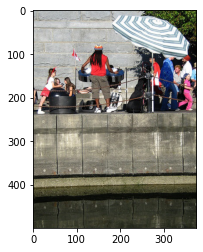

Caption: man in white shirt is standing on the street


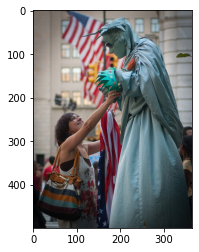

Caption: man in white shirt and hat make no shirt


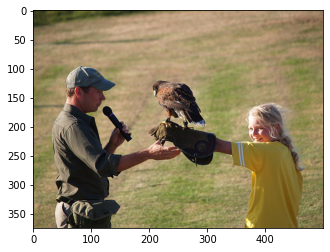

Caption: dog jumps over hurdle


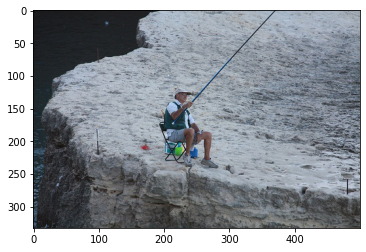

Caption: man is standing on top of cliff overlooking the ocean


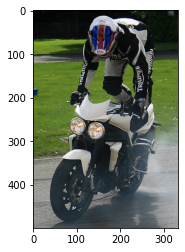

Caption: two police bike race


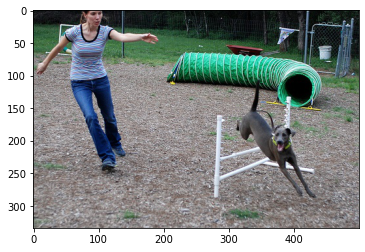

Caption: dog is jumping over hurdle


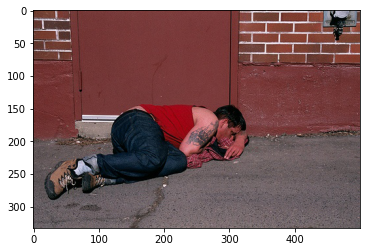

Caption: man in red shirt is sitting on the edge of cement wall


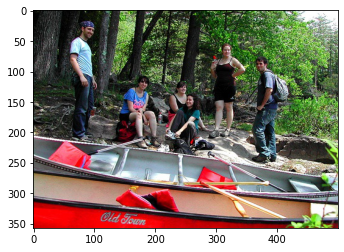

Caption: two people are in field of grass


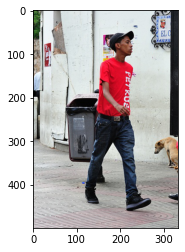

Caption: man in beige jacket is standing on sidewalk between some stone steps


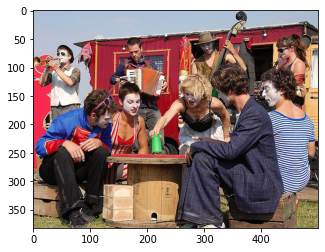

Caption: two children are sitting on the floor on the floor


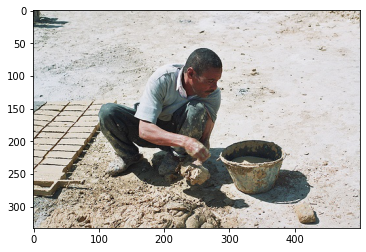

Caption: man in red shirt and jeans is standing on rock near some rocks


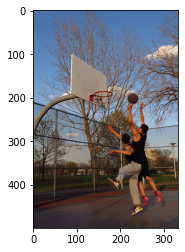

Caption: two men are playing in the street


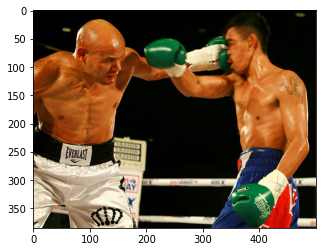

Caption: two young boys are playing basketball on court


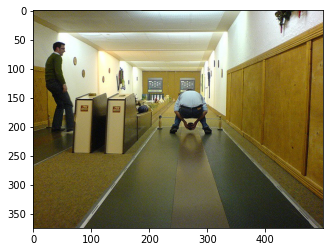

Caption: two people work on sidewalk near building


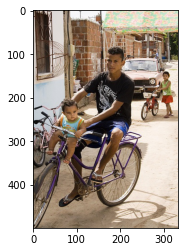

Caption: man in red shirt and hat is riding bicycle down the street


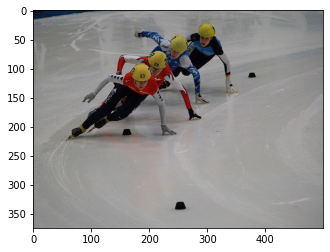

Caption: two hockey players are fighting on the ice


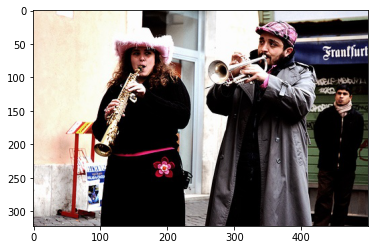

Caption: man in white shirt and hat is playing the guitar


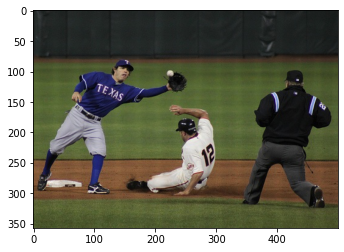

Caption: two boys play baseball on field


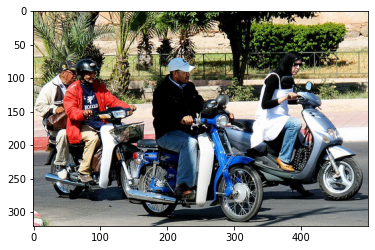

Caption: man in red shirt and hat is riding unicycle down street


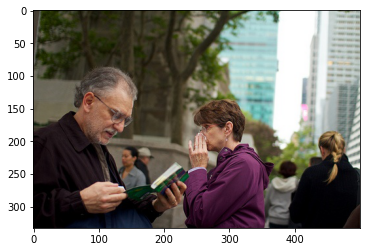

Caption: man in black jacket and black cap is standing in front of students


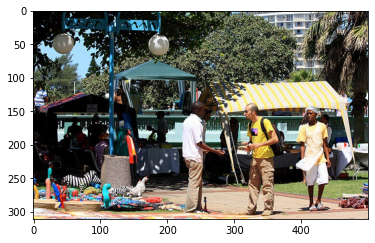

Caption: man in white shirt stands near younger man in black shirt


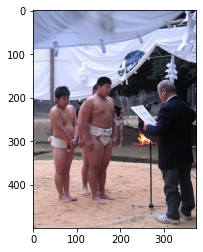

Caption: two young boys are playing in water fountain


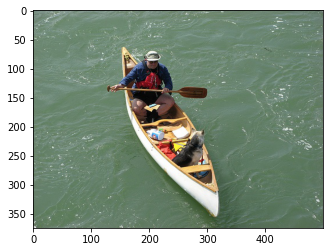

Caption: man paddles canoe in the ocean


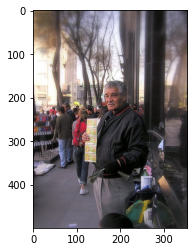

Caption: man in black jacket and tie reads on his bicycle


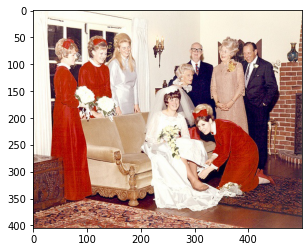

Caption: three children climb on bed


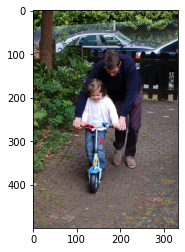

Caption: small child in blue shirt and blue pants is playing with red toy


In [ ]:
#making predictions on test data
# lst2 = []
for z in range(len(encoding_test)):
  pic = list(encoding_test.keys())[z]
  image = encoding_test[pic].reshape((1,2048))
  x=plt.imread(images+pic)
  plt.imshow(x)
  plt.show()
  print("Caption:",greedySearch2(image))